# Our custom WorldStrat dataset 

Based on some kaggle code: 
https://www.kaggle.com/code/egemenyorulmaz/worldstrat-hr-egemen-model

**Notes**

1. We load the HR RGB pngs which are uint8 [0, 255]. We normalize to float [0, 1]
2. We load the LR RGB bands from the tiff (which contains all 12 sentinel2 bands). This data seems already normalized (probably original 12bit values /10k). Values go above 1. We clip to [0, 1].

In [3]:
import os
import numpy as np
import cv2
import tifffile
import torch
import torch.nn as nn
from torch.utils.data import Dataset

import pandas as pd
from matplotlib import pyplot as plt    

from data import WorldStratDatasetFrame

In [2]:
def visualize_hr_lr_images(lr_images, hr_image, num_show_lr_samples=4, show_title=True):
    fig_h = 5
    fig, ax = plt.subplots(1, num_show_lr_samples + 1, figsize=((num_show_lr_samples+1)*fig_h, fig_h))
    ax[0].imshow(hr_image.squeeze().permute(1, 2, 0))
    ax[0].axis('off')

    if show_title:
        ax[0].set_title('HR image')

    for j in range(num_show_lr_samples):
        ax[j+1].imshow(lr_images[j].permute(1, 2, 0))
        ax[j+1].axis('off')
        if show_title:
            ax[j+1].set_title(f'LR image {j+1}')
    plt.tight_layout()
    plt.show()
    

sample:  0
area name:  UNHCR-LBNs006446
/home/nlang/data/worldstrat_kaggle/hr_dataset/12bit/UNHCR-LBNs006446/UNHCR-LBNs006446_rgb.png
(1054, 1054, 3)
lr shape:  torch.Size([7, 162, 155, 3])
hr shape:  torch.Size([1, 512, 512, 3])


/home/nlang/code/satellite_sr/data.py:358: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  lr_image = torch.tensor(lr_image)


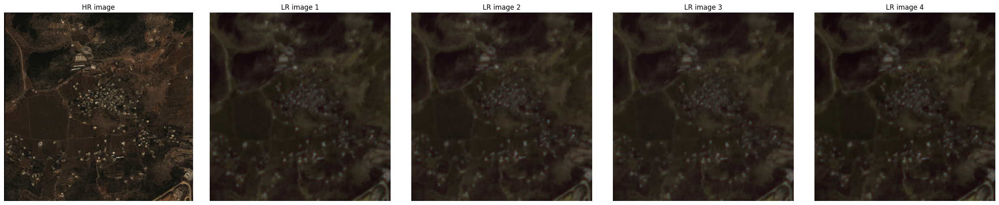

sample:  1
area name:  Landcover-774841
/home/nlang/data/worldstrat_kaggle/hr_dataset/12bit/Landcover-774841/Landcover-774841_rgb.png
(1054, 1054, 3)
lr shape:  torch.Size([7, 159, 157, 3])
hr shape:  torch.Size([1, 512, 512, 3])


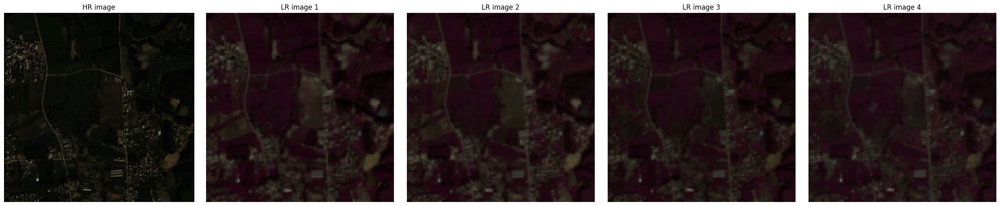

sample:  2
area name:  Landcover-1282806
/home/nlang/data/worldstrat_kaggle/hr_dataset/12bit/Landcover-1282806/Landcover-1282806_rgb.png
(1054, 1054, 3)
lr shape:  torch.Size([7, 159, 157, 3])
hr shape:  torch.Size([1, 512, 512, 3])


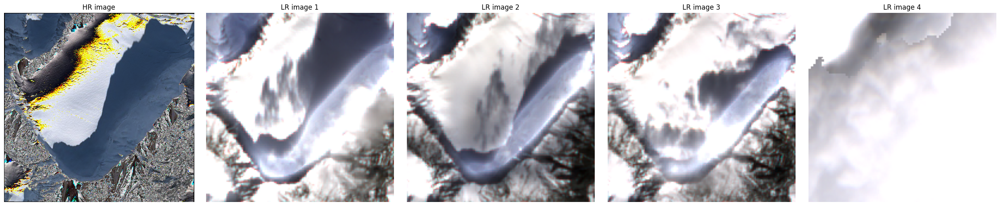

sample:  3
area name:  Landcover-777656
/home/nlang/data/worldstrat_kaggle/hr_dataset/12bit/Landcover-777656/Landcover-777656_rgb.png
(1054, 1054, 3)
lr shape:  torch.Size([7, 152, 164, 3])
hr shape:  torch.Size([1, 512, 512, 3])


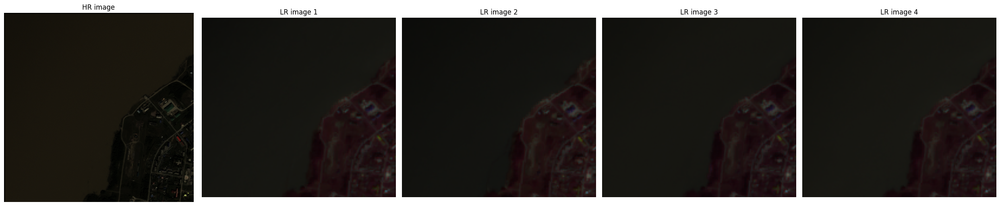

sample:  4
area name:  Landcover-1458476
/home/nlang/data/worldstrat_kaggle/hr_dataset/12bit/Landcover-1458476/Landcover-1458476_rgb.png
(1054, 1054, 3)
lr shape:  torch.Size([7, 156, 160, 3])
hr shape:  torch.Size([1, 512, 512, 3])


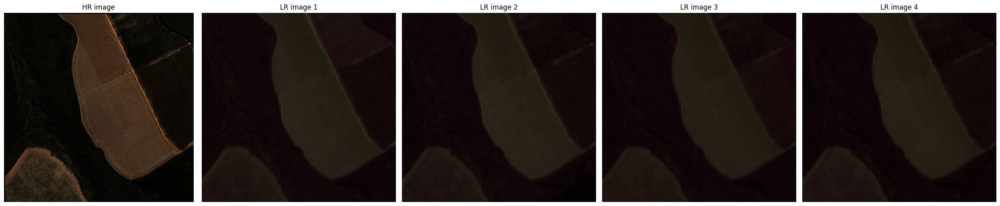

sample:  5
area name:  UNHCR-SDNs015641
/home/nlang/data/worldstrat_kaggle/hr_dataset/12bit/UNHCR-SDNs015641/UNHCR-SDNs015641_rgb.png
(1054, 1054, 3)
lr shape:  torch.Size([7, 160, 156, 3])
hr shape:  torch.Size([1, 512, 512, 3])


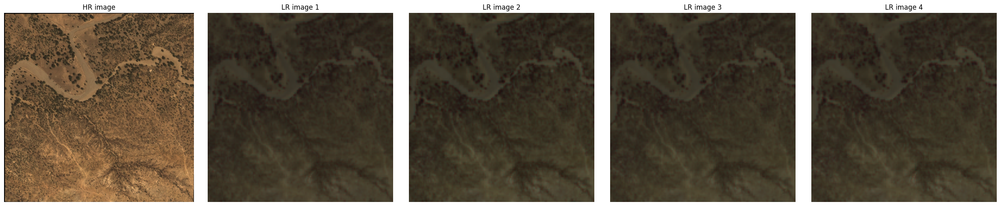

sample:  6
area name:  Landcover-743192
/home/nlang/data/worldstrat_kaggle/hr_dataset/12bit/Landcover-743192/Landcover-743192_rgb.png
(1054, 1054, 3)
lr shape:  torch.Size([7, 157, 159, 3])
hr shape:  torch.Size([1, 512, 512, 3])


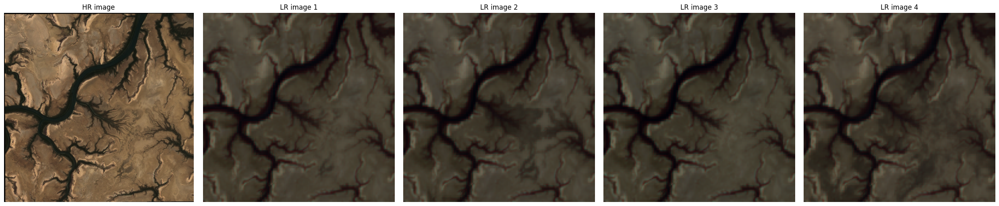

sample:  7
area name:  UNHCR-BFAs004528
/home/nlang/data/worldstrat_kaggle/hr_dataset/12bit/UNHCR-BFAs004528/UNHCR-BFAs004528_rgb.png
(1054, 1054, 3)
lr shape:  torch.Size([7, 159, 157, 3])
hr shape:  torch.Size([1, 512, 512, 3])


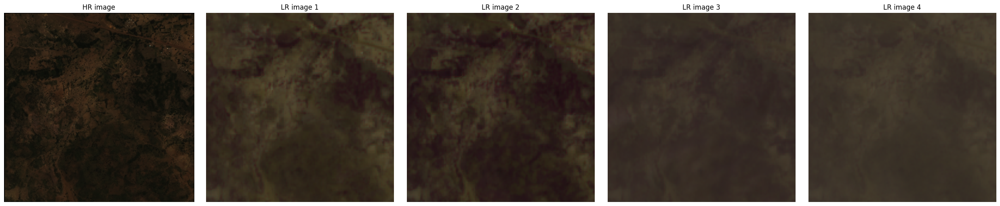

sample:  8
area name:  Landcover-776340
/home/nlang/data/worldstrat_kaggle/hr_dataset/12bit/Landcover-776340/Landcover-776340_rgb.png
(1054, 1054, 3)
lr shape:  torch.Size([7, 153, 163, 3])
hr shape:  torch.Size([1, 512, 512, 3])


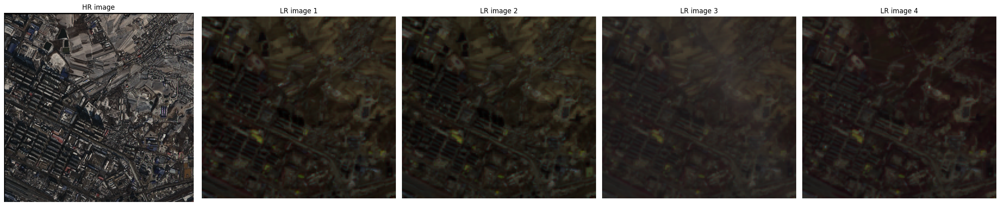

sample:  9
area name:  Landcover-1295513
/home/nlang/data/worldstrat_kaggle/hr_dataset/12bit/Landcover-1295513/Landcover-1295513_rgb.png
(1054, 1054, 3)
lr shape:  torch.Size([7, 158, 158, 3])
hr shape:  torch.Size([1, 512, 512, 3])


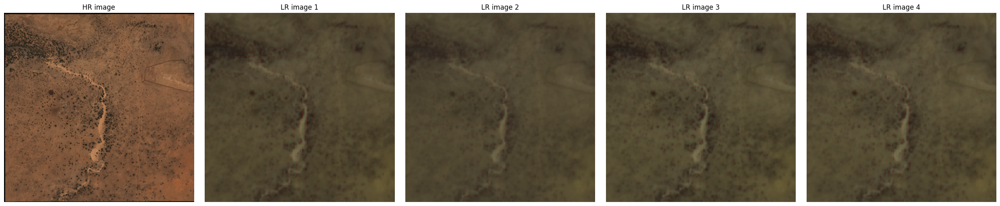

sample:  10
area name:  ASMSpotter-35-2-3
/home/nlang/data/worldstrat_kaggle/hr_dataset/12bit/ASMSpotter-35-2-3/ASMSpotter-35-2-3_rgb.png
(1054, 1054, 3)
lr shape:  torch.Size([7, 159, 158, 3])
hr shape:  torch.Size([1, 512, 512, 3])


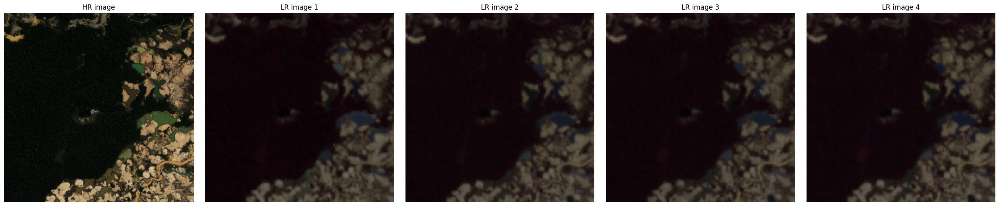

sample:  11
area name:  Landcover-769031
/home/nlang/data/worldstrat_kaggle/hr_dataset/12bit/Landcover-769031/Landcover-769031_rgb.png
(1054, 1054, 3)
lr shape:  torch.Size([7, 155, 161, 3])
hr shape:  torch.Size([1, 512, 512, 3])


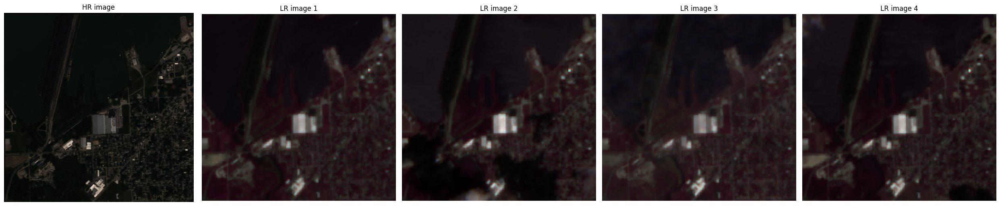

sample:  12
area name:  Landcover-770541
/home/nlang/data/worldstrat_kaggle/hr_dataset/12bit/Landcover-770541/Landcover-770541_rgb.png
(1054, 1054, 3)
lr shape:  torch.Size([7, 159, 157, 3])
hr shape:  torch.Size([1, 512, 512, 3])


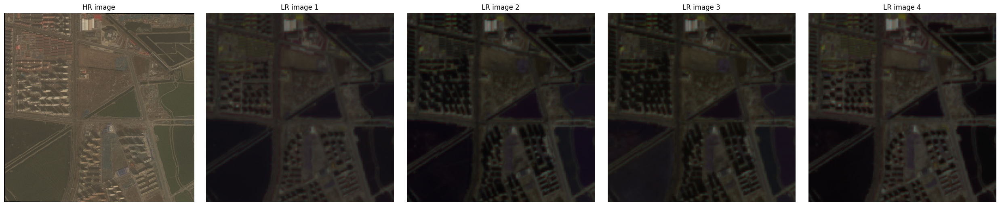

sample:  13
area name:  Landcover-772893
/home/nlang/data/worldstrat_kaggle/hr_dataset/12bit/Landcover-772893/Landcover-772893_rgb.png
(1054, 1054, 3)
lr shape:  torch.Size([7, 161, 155, 3])
hr shape:  torch.Size([1, 512, 512, 3])


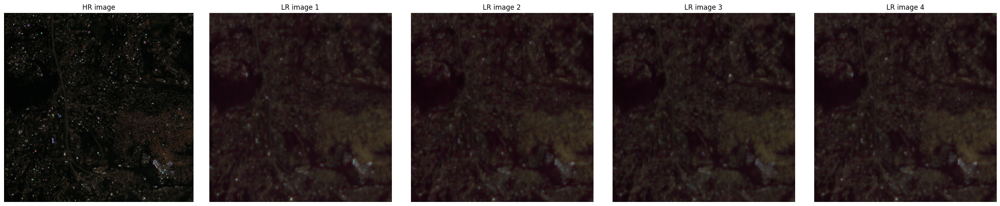

sample:  14
area name:  Landcover-777118
/home/nlang/data/worldstrat_kaggle/hr_dataset/12bit/Landcover-777118/Landcover-777118_rgb.png
(1054, 1054, 3)
lr shape:  torch.Size([7, 158, 158, 3])
hr shape:  torch.Size([1, 512, 512, 3])


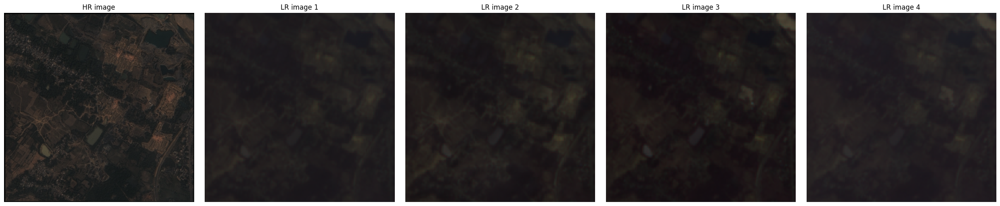

sample:  15
area name:  UNHCR-SYRs008164
/home/nlang/data/worldstrat_kaggle/hr_dataset/12bit/UNHCR-SYRs008164/UNHCR-SYRs008164_rgb.png
(1054, 1054, 3)
lr shape:  torch.Size([7, 159, 157, 3])
hr shape:  torch.Size([1, 512, 512, 3])


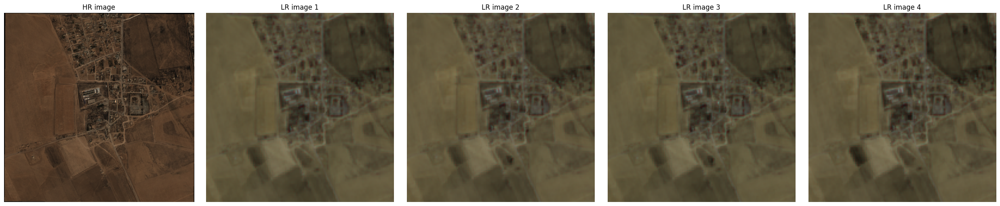

sample:  16
area name:  UNHCR-UGAs032269
/home/nlang/data/worldstrat_kaggle/hr_dataset/12bit/UNHCR-UGAs032269/UNHCR-UGAs032269_rgb.png
(1054, 1054, 3)
lr shape:  torch.Size([7, 158, 158, 3])
hr shape:  torch.Size([1, 512, 512, 3])


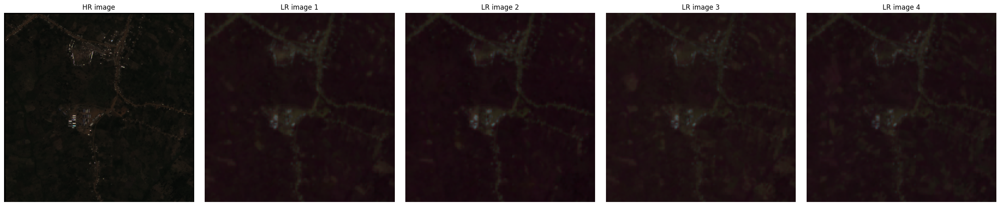

sample:  17
area name:  ASMSpotter-13-2-2
/home/nlang/data/worldstrat_kaggle/hr_dataset/12bit/ASMSpotter-13-2-2/ASMSpotter-13-2-2_rgb.png
(1054, 1054, 3)
lr shape:  torch.Size([7, 159, 158, 3])
hr shape:  torch.Size([1, 512, 512, 3])


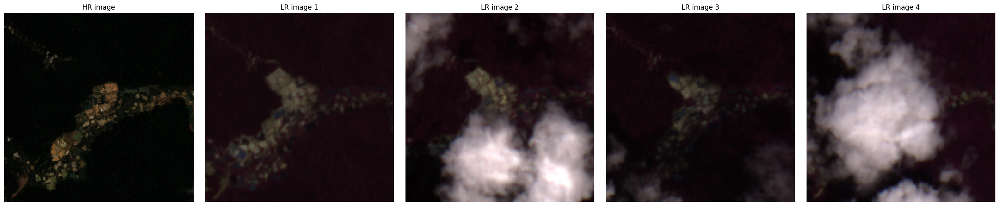

sample:  18
area name:  ASMSpotter-33-3-2
/home/nlang/data/worldstrat_kaggle/hr_dataset/12bit/ASMSpotter-33-3-2/ASMSpotter-33-3-2_rgb.png
(1054, 1054, 3)
lr shape:  torch.Size([7, 159, 157, 3])
hr shape:  torch.Size([1, 512, 512, 3])


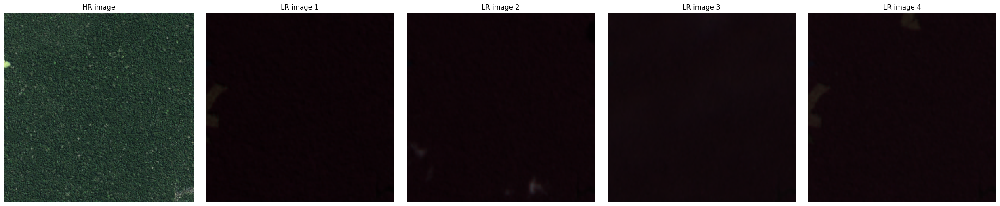

sample:  19
area name:  Landcover-768922
/home/nlang/data/worldstrat_kaggle/hr_dataset/12bit/Landcover-768922/Landcover-768922_rgb.png
(1054, 1054, 3)
lr shape:  torch.Size([7, 161, 155, 3])
hr shape:  torch.Size([1, 512, 512, 3])


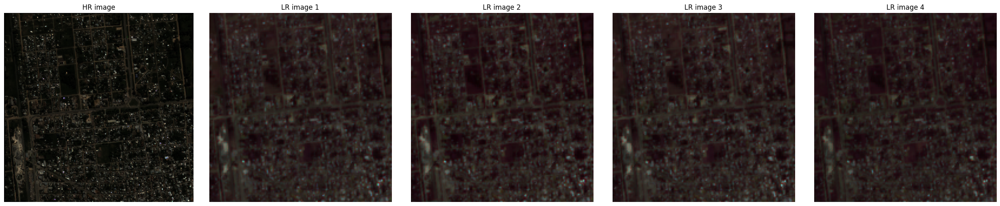

In [ ]:
# Using the WorldStratDatasetFrame
dataset_root = '/home/nlang/data/worldstrat_kaggle'
area_names = ["UNHCR-LBNs006446"]

dataset_root = '/home/nlang/data/worldstrat_kaggle'
hr_dataset = "{}/hr_dataset/12bit".format(dataset_root)
area_names = os.listdir(hr_dataset)

sample_indices = range(20) #[0, 8, 14, 6, 17]
for i in sample_indices:
    print("sample: ", i)
    print("area name: ", area_names[i])

    # init dataset_frame
    dataset_frame = WorldStratDatasetFrame(dataset_root, area_name=area_names[i])

    lr_images = []
    for frame_id in range(0, 7):
        
        if frame_id == 0:
            hr_image = dataset_frame.hr_image.unsqueeze(0)
        sample = dataset_frame[frame_id]
        lr_image = sample['lr_target']
        lr_images.append(lr_image)
    lr_images = torch.stack(lr_images)
    
    print("lr shape: ", lr_images.shape)
    print("hr shape: ", hr_image.shape)

    visualize_hr_lr_images(lr_images.permute(0, 3, 1, 2), hr_image.permute(0, 3, 1, 2), num_show_lr_samples=8)


In [5]:
stop

NameError: name 'stop' is not defined

# Visualize using Batch datasets

In [15]:
class WorldStratDatasetBatch(Dataset):
    def __init__(self, dataset_root, area_names=None):
        """
        Args:
            dataset_root (str): Path to the dataset.
            area_names (list): List of unique area names.
        """

        self.dataset_root = '/home/nlang/data/worldstrat_kaggle'
        self.hr_dataset = "{}/hr_dataset/12bit".format(dataset_root)
        self.lr_dataset = "{}/lr_dataset".format(dataset_root)
        self.metadata_df = pd.read_csv("{}/metadata.csv".format(dataset_root))
        if area_names is None:
            print("Using all area names")
            self.area_names = os.listdir(self.hr_dataset)
        else:
            self.area_names = area_names

    
    def __len__(self):
        return len(self.area_names)
    
    def get_hr(self, area_name):
        """Loads and processes the high-resolution image."""
        hr_rgb_path = os.path.join(self.hr_dataset, area_name, f"{area_name}_rgb.png")
        
        hr_rgb_img = cv2.imread(hr_rgb_path, cv2.IMREAD_UNCHANGED)
        hr_rgb_img = cv2.cvtColor(hr_rgb_img, cv2.COLOR_BGR2RGB)
        #hr_rgb_img_img = cv2.resize(hr_rgb_img_img, (self.hr_img_size, self.hr_img_size))
        
        return hr_rgb_img.astype(np.float32) / 255.0  # Normalize
    
    def get_lr(self, area_name):
        """Loads and processes the low-resolution images."""
        lr_sample_path = os.path.join(self.lr_dataset, area_name, "L2A")
        input_sub_samples = []
        
        for i in range(1, 9):
            lr_rgb_path = os.path.join(lr_sample_path, f"{area_name}-{i}-L2A_data.tiff")
            lr_rgb_img = tifffile.imread(lr_rgb_path)[:, :, 4:1:-1]  # Select RGB bands and reverse order
            #lr_rgb_img = cv2.resize(lr_rgb_img, (self.lr_img_size, self.lr_img_size))
            input_sub_samples.append(lr_rgb_img)
        
        return np.array(input_sub_samples, dtype=np.float32).clip(0, 1)  # Data is already normalized, but needs to be clipped
    
    def __getitem__(self, idx):
        area_name = self.area_names[idx]
        lr_images = self.get_lr(area_name)  # Shape: (8, lr_img_size, lr_img_size, 3)
        hr_image = self.get_hr(area_name)   # Shape: (hr_img_size, hr_img_size, 3)
        
        # Convert to torch tensors
        lr_images = torch.tensor(lr_images).permute(0, 3, 1, 2)  # (8, 3, lr_img_size, lr_img_size)
        hr_image = torch.tensor(hr_image).permute(2, 0, 1)[None, ...]  # (3, hr_img_size, hr_img_size)
        
        return lr_images, hr_image

In [16]:
# init WorldStratDatasetBatch
dataset_root = '/home/nlang/data/worldstrat_kaggle'
dataset = WorldStratDatasetBatch(dataset_root, area_names=None)
print("length of dataset: ", len(dataset))

Using all area names
length of dataset:  3928


In [17]:
dataset_frame = WorldStratDatasetFrame(dataset_root, area_name="UNHCR-LBNs006446")

sample:  0
area name:  UNHCR-LBNs006446
lr shape:  torch.Size([8, 3, 162, 155])
hr shape:  torch.Size([1, 3, 1054, 1054])


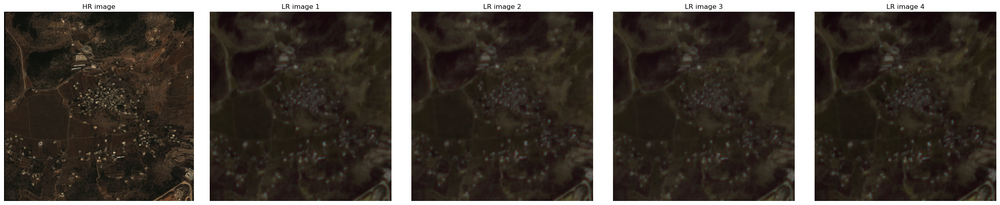

sample:  9
area name:  Landcover-1295513
lr shape:  torch.Size([8, 3, 158, 158])
hr shape:  torch.Size([1, 3, 1054, 1054])


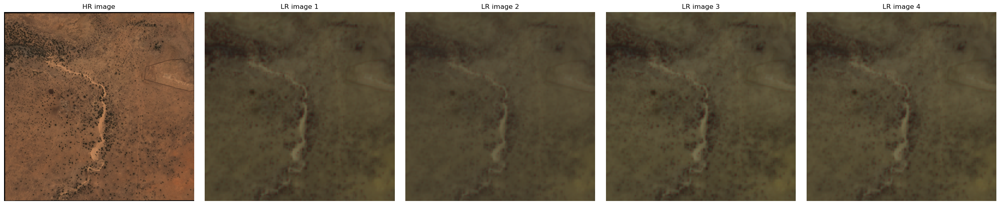

sample:  14
area name:  Landcover-777118
lr shape:  torch.Size([8, 3, 158, 158])
hr shape:  torch.Size([1, 3, 1054, 1054])


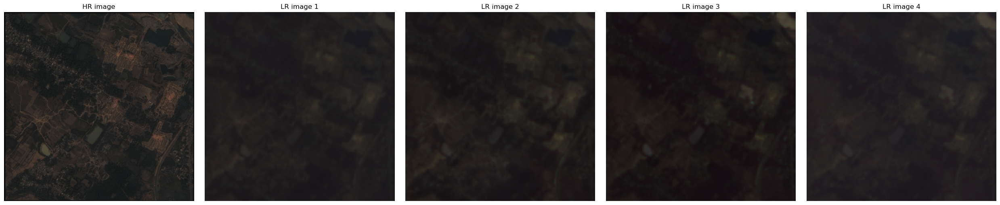

sample:  6
area name:  Landcover-743192
lr shape:  torch.Size([8, 3, 157, 159])
hr shape:  torch.Size([1, 3, 1054, 1054])


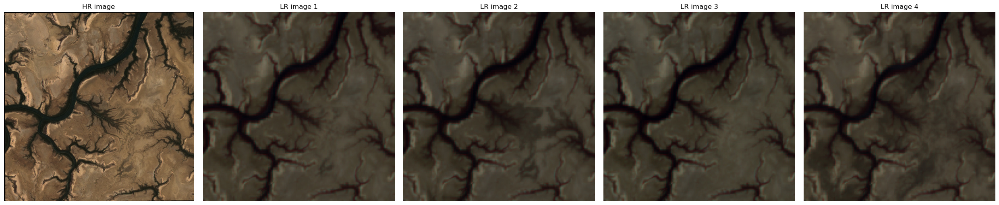

sample:  17
area name:  ASMSpotter-13-2-2
lr shape:  torch.Size([8, 3, 159, 158])
hr shape:  torch.Size([1, 3, 1054, 1054])


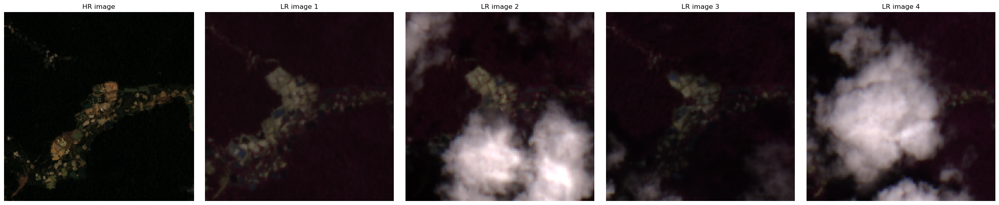

In [19]:
sample_indices = [0, 9, 14, 6, 17]
for i in sample_indices:
    print("sample: ", i)
    print("area name: ", dataset.area_names[i])
    lr_images, hr_image = dataset[i]
    print("lr shape: ", lr_images.shape)
    print("hr shape: ", hr_image.shape)

    visualize_hr_lr_images(lr_images, hr_image, num_show_lr_samples=4)
